In [ ]:
!pip install tensorflow-addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 9.5 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
from glob import glob
from tqdm import tqdm
from PIL import Image
from random import random



# Data
import matplotlib.pyplot as plt
import tensorflow.image as tfi
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Model Functions
from tensorflow.keras.models import Model, load_model, Sequential
from tensorflow.keras.initializers import RandomNormal

from tensorflow.keras.layers import ReLU, Input, Conv2D, Dropout, LeakyReLU, Activation, concatenate, ZeroPadding2D, Conv2DTranspose
from tensorflow_addons.layers import InstanceNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.utils import plot_model

# Set random seed for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

In [ ]:
def show_image(image, title=None):
    '''
    The function takes in an image and plots it using Matplotlib.
    '''
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

In [ ]:
image_path = '/content/dataset/monet/00001.jpg'  # Replace with the path to your image file

# Open the image using Pillow
image = Image.open(image_path)

# Get the size of the image
image_size = image.size

# Print the width and height of the image
width, height = image_size
print("Image size:", width, "x", height)

Image size: 256 x 256


In [ ]:
root_monet_path = '/content/dataset/monet'
root_photo_path = '/content/dataset/photo'
monet_paths = sorted(glob(root_monet_path + '/*.jpg'))[:1000]
photo_paths = sorted(glob(root_photo_path + '/*.jpg'))[:1000]

In [ ]:
print("length of monet_paths is",len(monet_paths))
print("length of photo_paths is",len(photo_paths))

length of monet_paths is 1000
length of photo_paths is 1000


In [ ]:
SIZE = 256
monet_images, photo_images = np.zeros(shape=(len(monet_paths),SIZE,SIZE,3)), np.zeros(shape=(len(photo_paths),SIZE,SIZE,3))
for i,(monet_path, photo_path) in tqdm(enumerate(zip(monet_paths, photo_paths)), desc='Loading'):

    monet_image = img_to_array(load_img(monet_path))
    monet_image = tfi.resize(tf.cast(monet_image, tf.float32)/255., (SIZE, SIZE))

    photo_image = img_to_array(load_img(photo_path))
    photo_image = tfi.resize(tf.cast(photo_image,tf.float32)/255., (SIZE, SIZE))

    # as the data is unpaired so we don't have to worry about, positioning the images.

    monet_images[i] = monet_image
    photo_images[i] = photo_image

Loading: 1000it [00:28, 34.60it/s]


In [ ]:
dataset = [monet_images, photo_images]

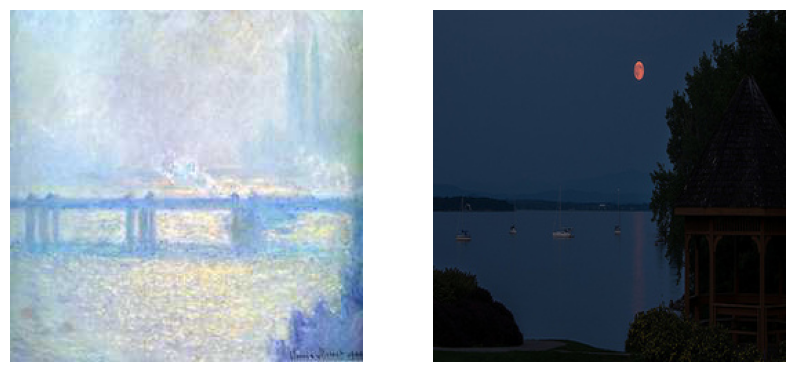

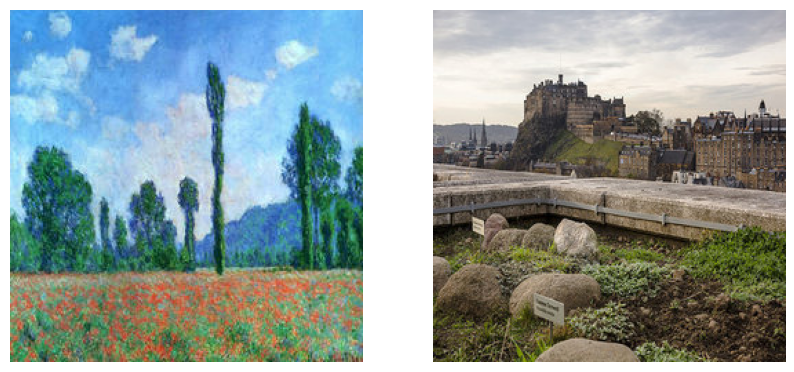

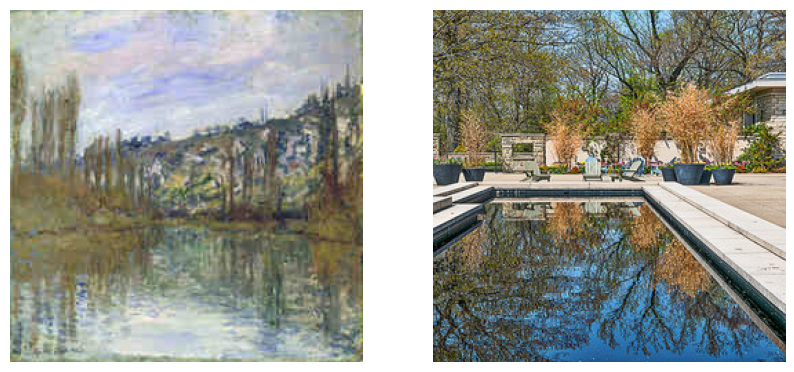

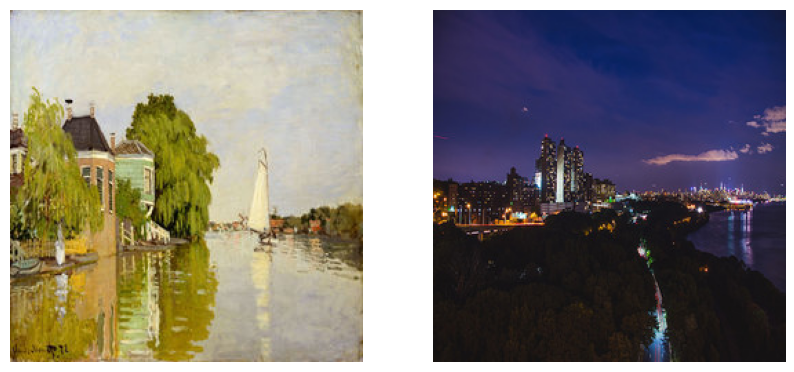

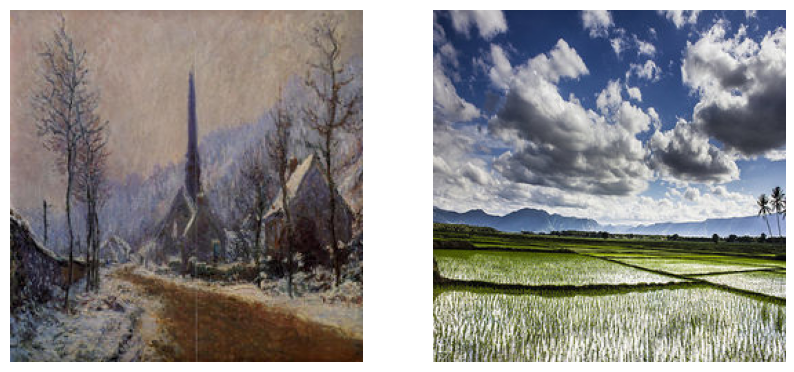

In [ ]:
for i in range(5):
    id = np.random.randint(len(monet_images))
    monet, photo = monet_images[id], photo_images[id]

    plt.figure(figsize=(10,8))

    plt.subplot(1,2,1)
    show_image(monet)

    plt.subplot(1,2,2)
    show_image(photo)
    plt.show()

In [ ]:
def show_preds(g_AB, g_BA,n_images=1):
    for i in range(n_images):

        id = np.random.randint(len(monet_images))
        monet, photo = monet_images[id], photo_images[id]
        monet_pred, photo_pred = g_BA.predict(tf.expand_dims(photo,axis=0))[0], g_AB.predict(tf.expand_dims(monet,axis=0))[0]

        plt.figure(figsize=(10,8))

        plt.subplot(1,4,1)
        show_image(monet, title='Original Monet')

        plt.subplot(1,4,2)
        show_image(photo_pred, title='Generated Photo')

        plt.subplot(1,4,3)
        show_image(photo, title='Original Photo')

        plt.subplot(1,4,4)
        show_image(monet_pred, title='Generated Monet')

        plt.tight_layout()
        plt.show()

In [ ]:
HtoZ_gen = load_model("/content/GeneratorHtoZ8.h5")
ZtoH_gen = load_model("/content/GeneratorZtoH8.h5")

1/1 [==============================] - 6s 6s/step


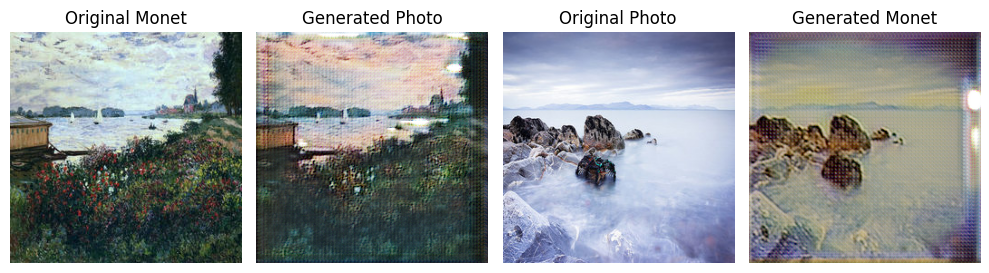

1/1 [==============================] - 5s 5s/step


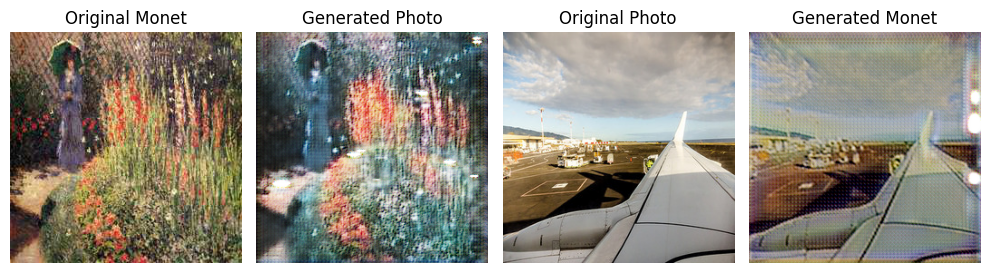

1/1 [==============================] - 5s 5s/step


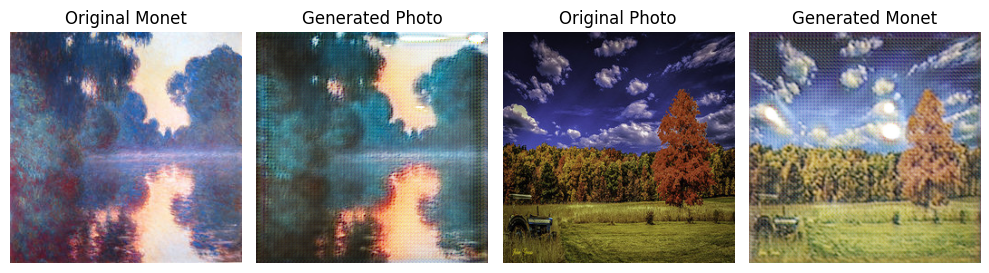

1/1 [==============================] - 5s 5s/step


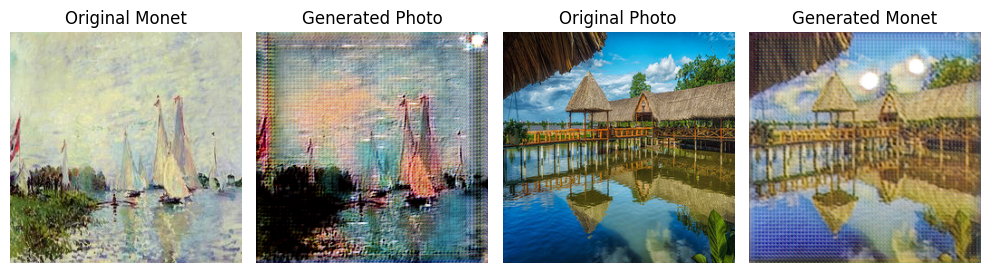

1/1 [==============================] - 5s 5s/step


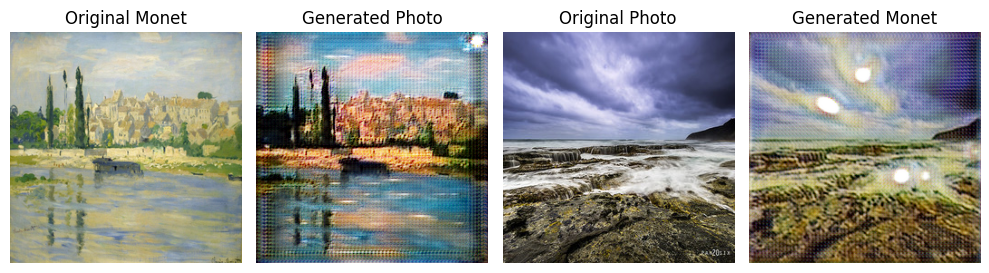

1/1 [==============================] - 6s 6s/step


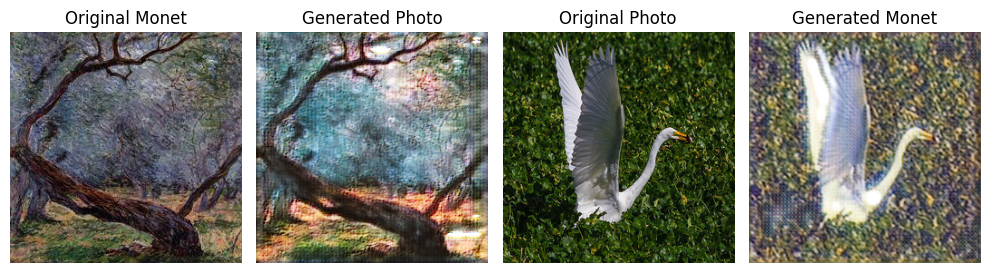

1/1 [==============================] - 6s 6s/step


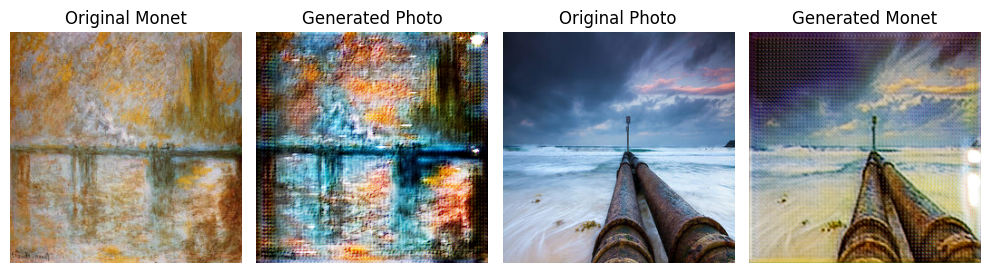

1/1 [==============================] - 5s 5s/step


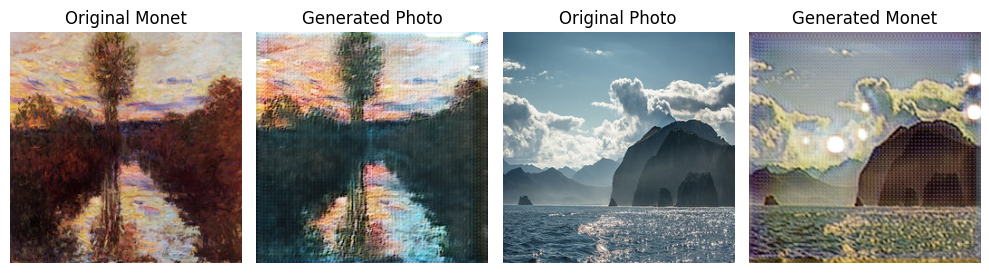

1/1 [==============================] - 5s 5s/step


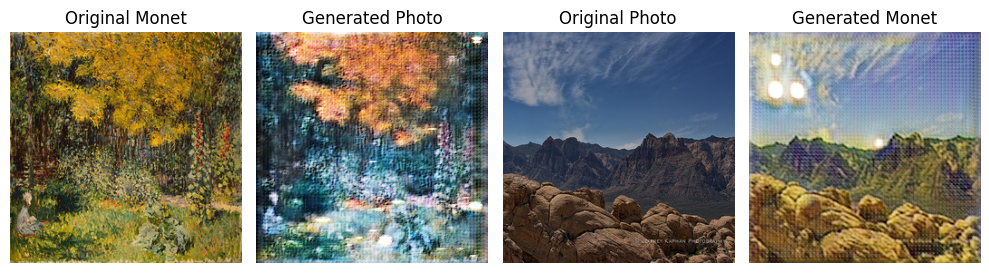

1/1 [==============================] - 5s 5s/step


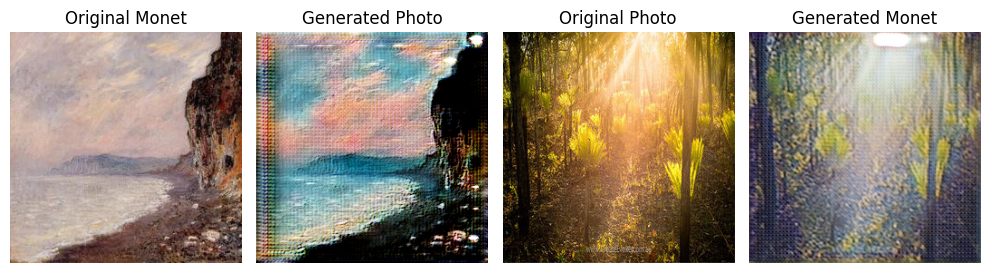

1/1 [==============================] - 5s 5s/step


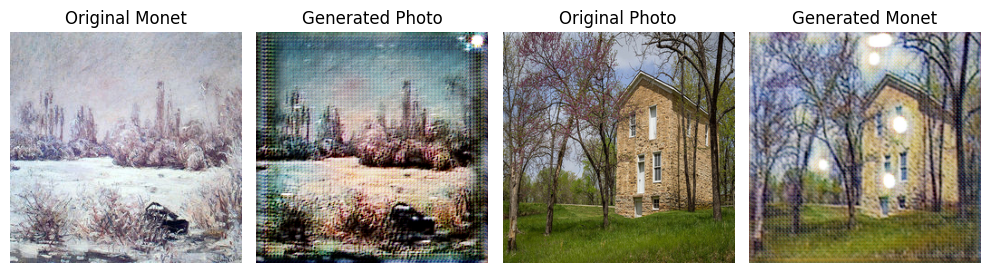

1/1 [==============================] - 5s 5s/step


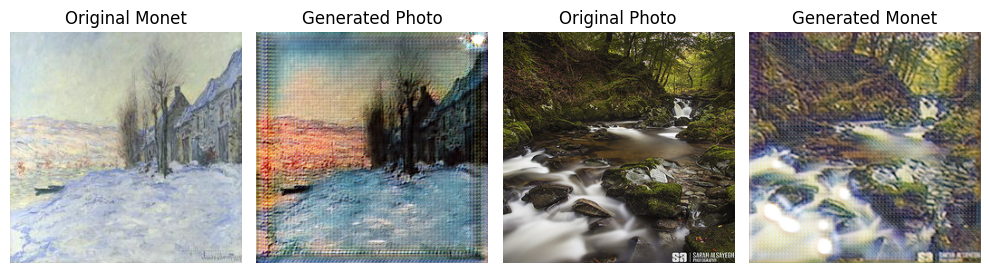

1/1 [==============================] - 6s 6s/step


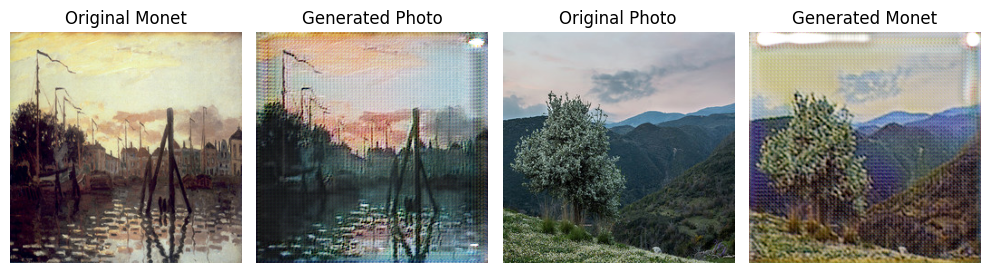

1/1 [==============================] - 6s 6s/step


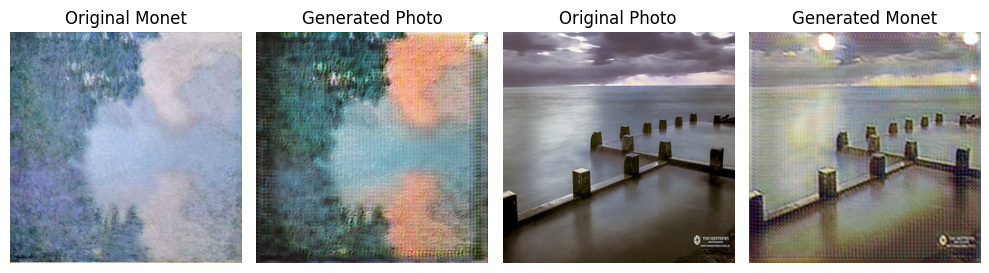

1/1 [==============================] - 6s 6s/step


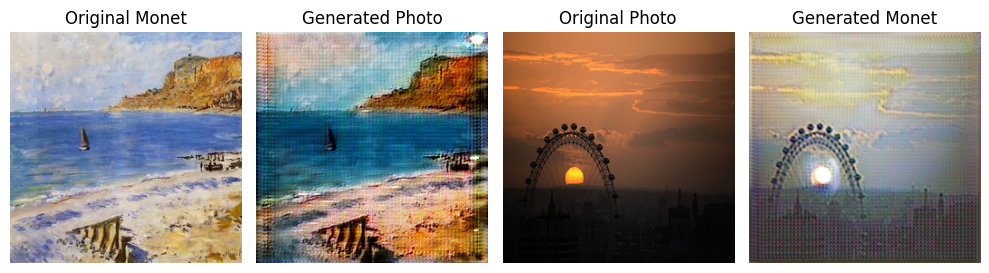

1/1 [==============================] - 5s 5s/step


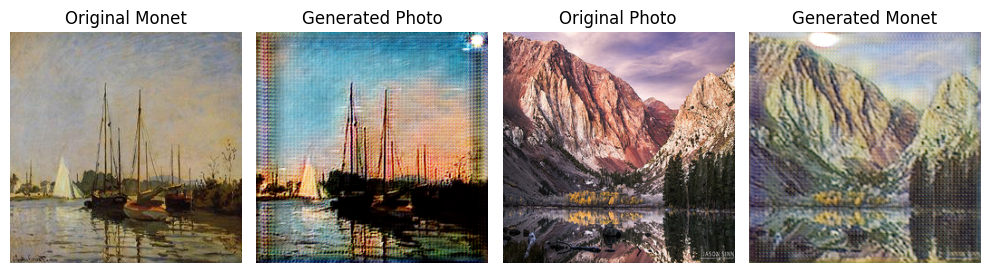

1/1 [==============================] - 5s 5s/step


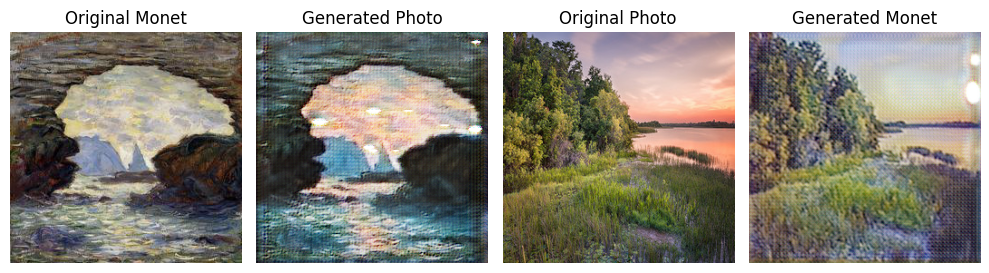

1/1 [==============================] - 5s 5s/step


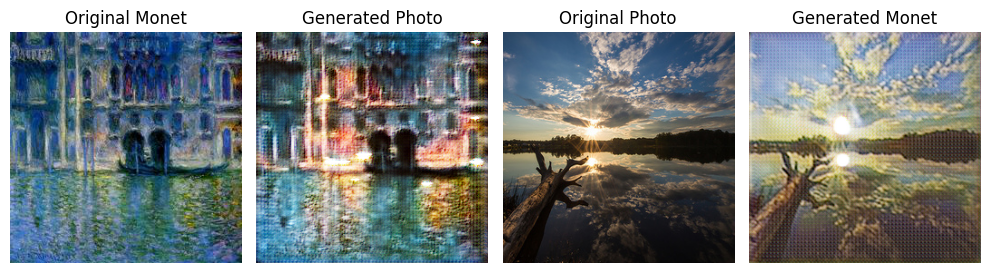

1/1 [==============================] - 5s 5s/step


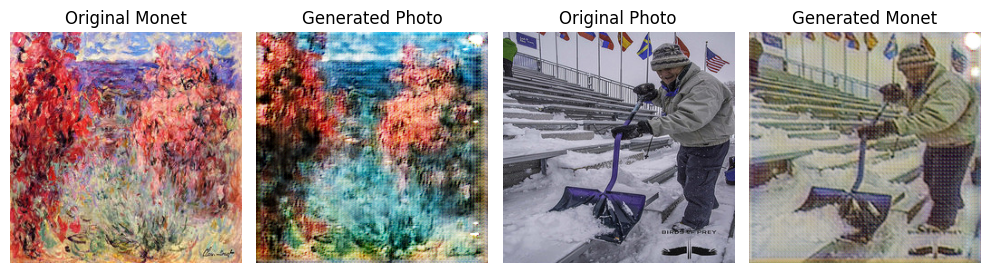

1/1 [==============================] - 5s 5s/step


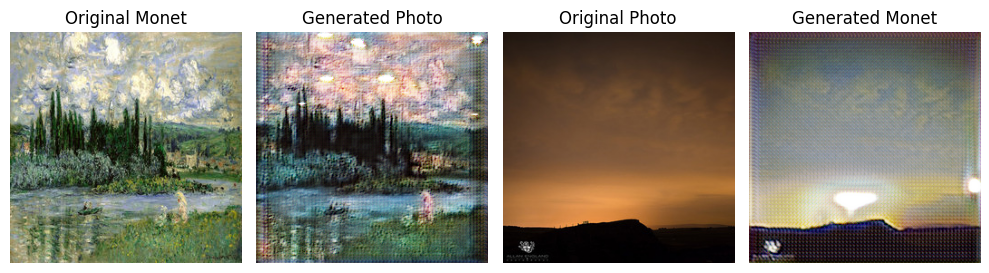

1/1 [==============================] - 5s 5s/step


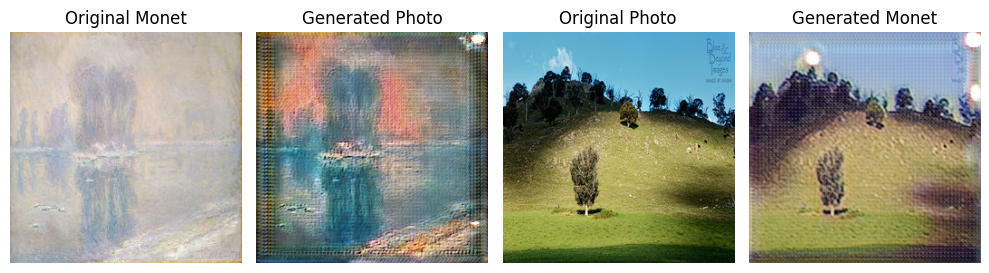

1/1 [==============================] - 5s 5s/step


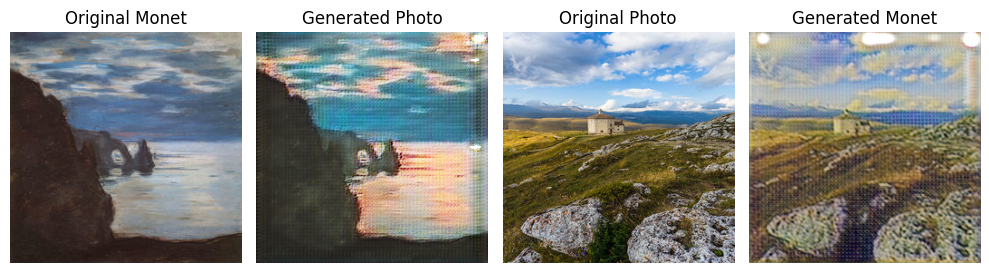

1/1 [==============================] - 6s 6s/step


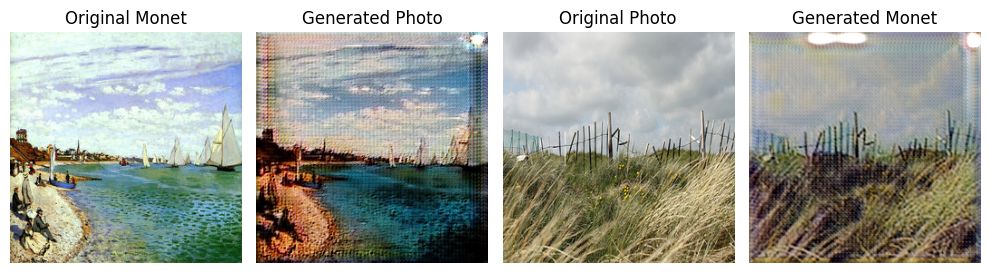

1/1 [==============================] - 6s 6s/step


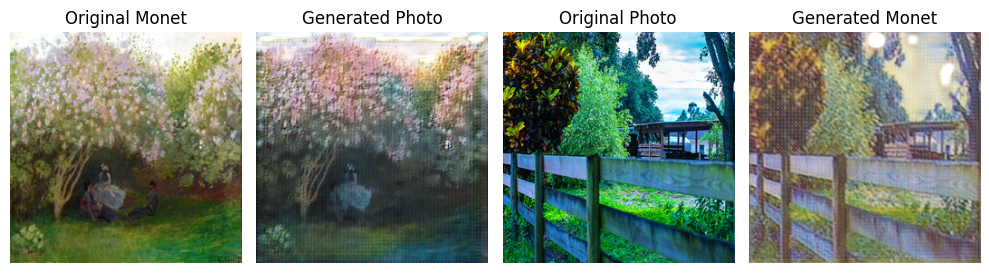

1/1 [==============================] - 6s 6s/step


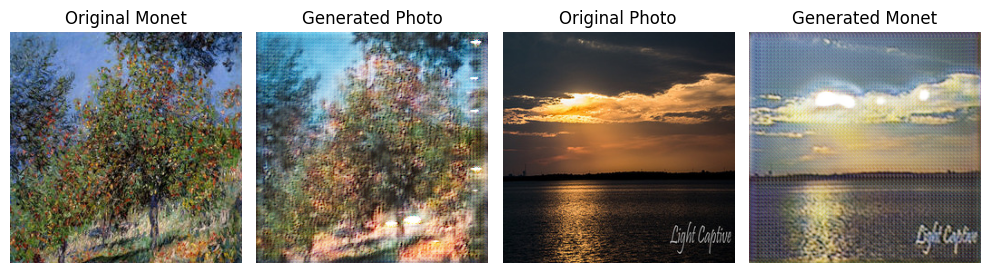

1/1 [==============================] - 6s 6s/step


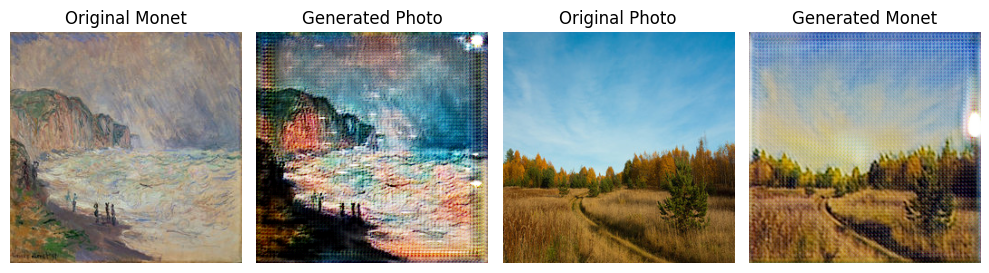

1/1 [==============================] - 5s 5s/step


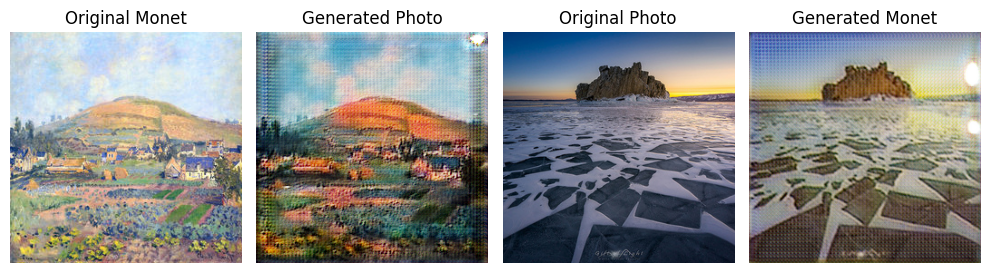

1/1 [==============================] - 5s 5s/step


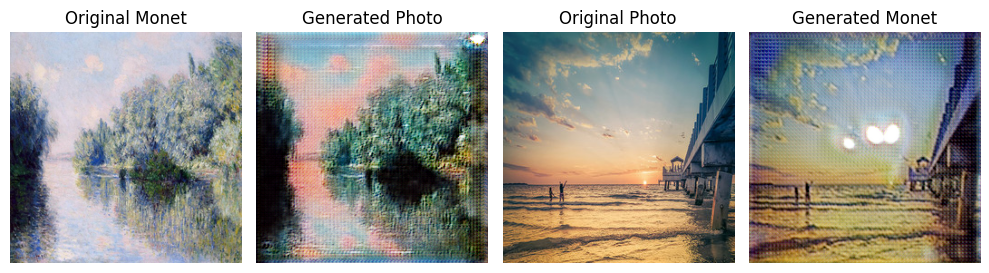

1/1 [==============================] - 5s 5s/step


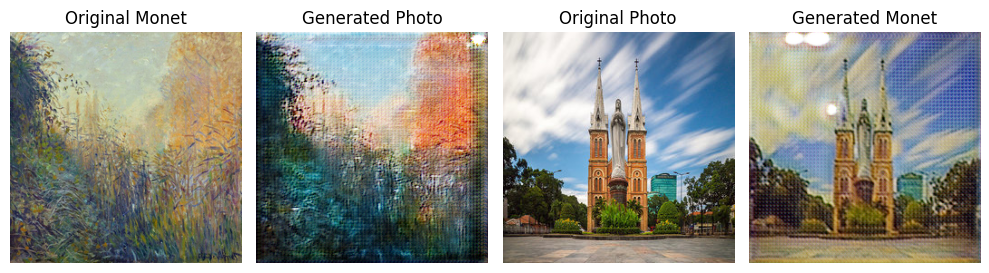

1/1 [==============================] - 5s 5s/step


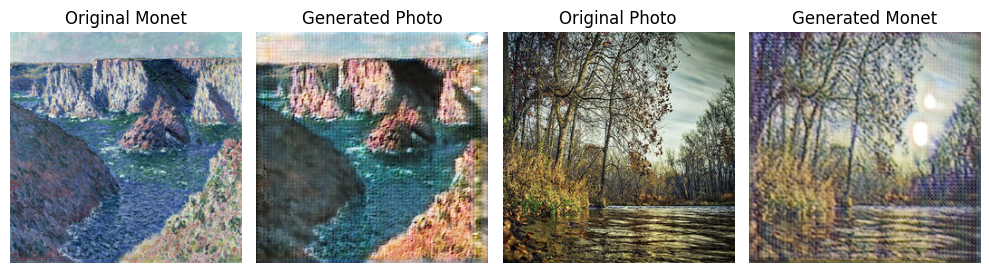

1/1 [==============================] - 5s 5s/step


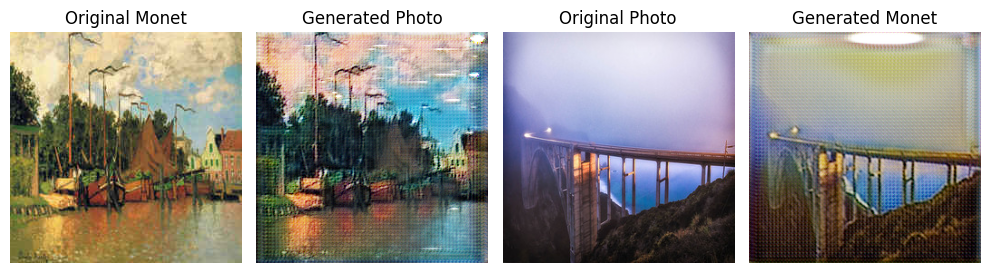

1/1 [==============================] - 5s 5s/step


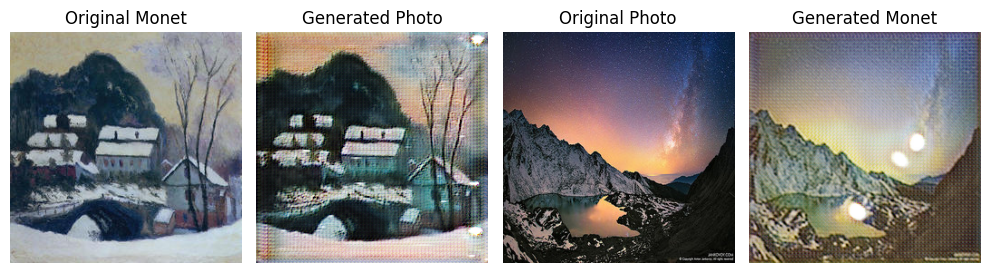

1/1 [==============================] - 6s 6s/step


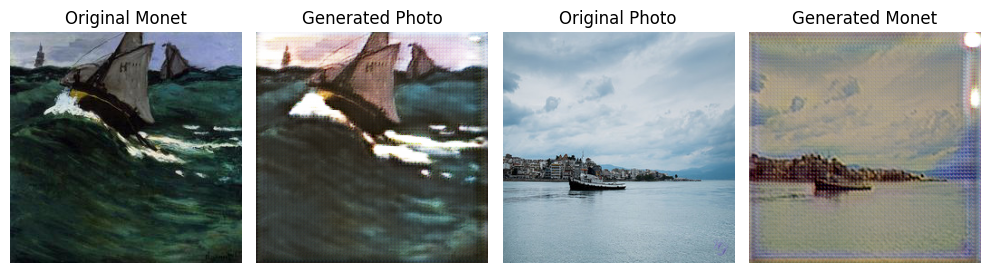

1/1 [==============================] - 6s 6s/step


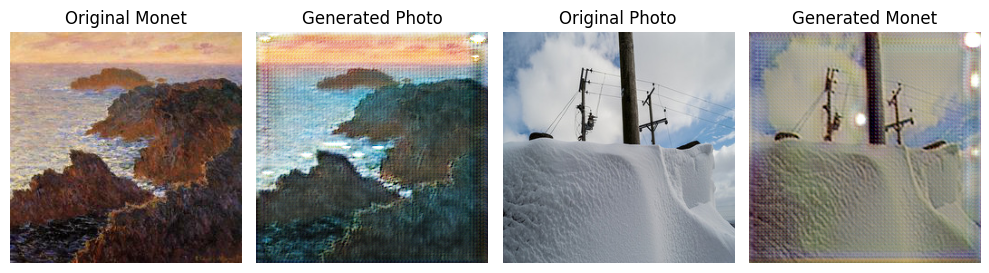

1/1 [==============================] - 6s 6s/step


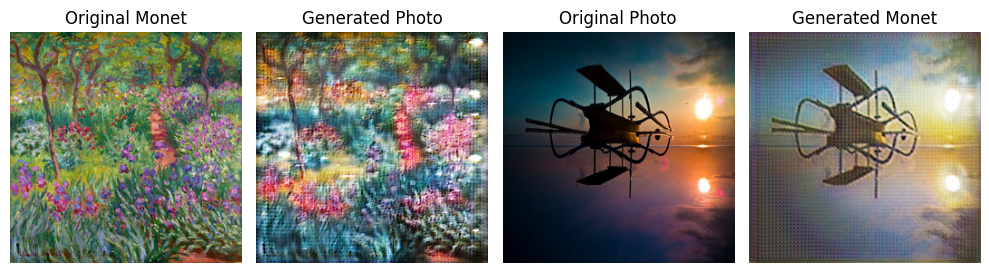

1/1 [==============================] - 6s 6s/step


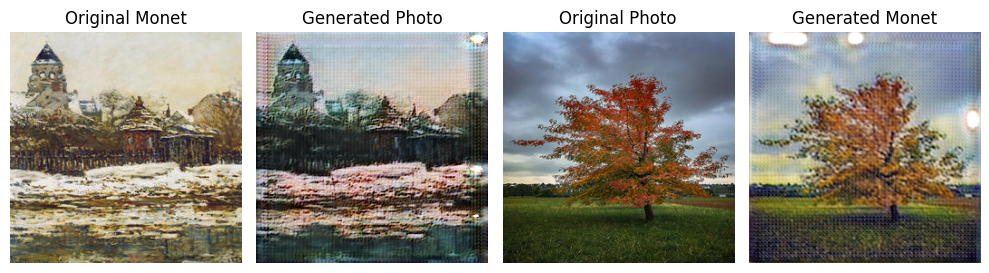

1/1 [==============================] - 6s 6s/step


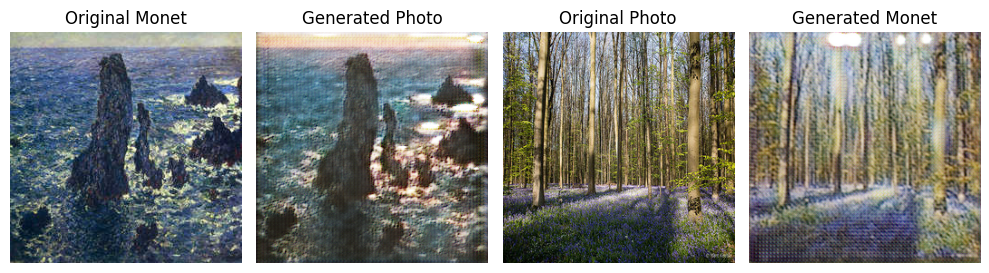

1/1 [==============================] - 5s 5s/step


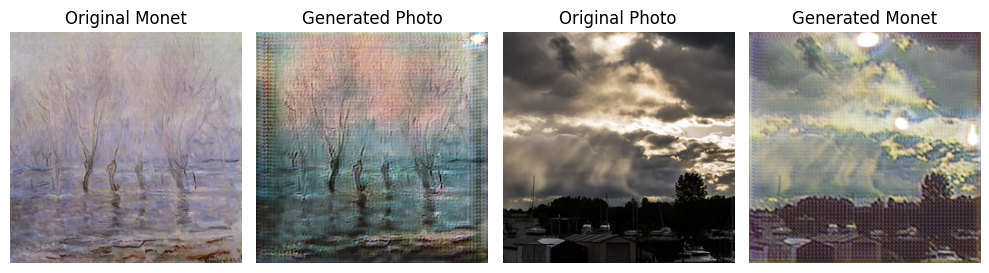

1/1 [==============================] - 5s 5s/step


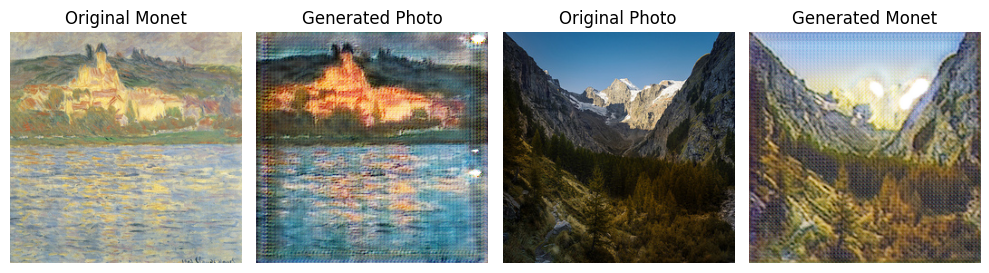

1/1 [==============================] - 5s 5s/step


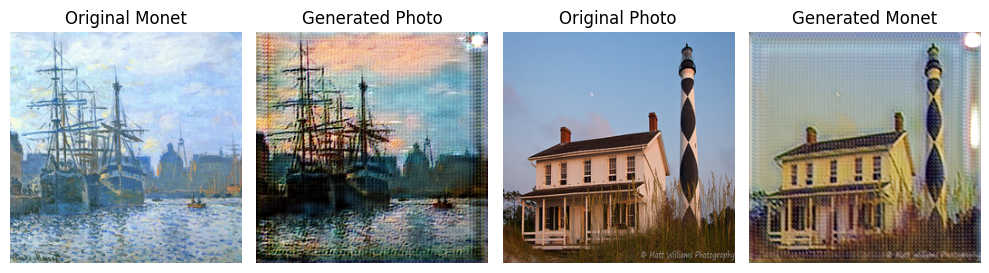

1/1 [==============================] - 5s 5s/step


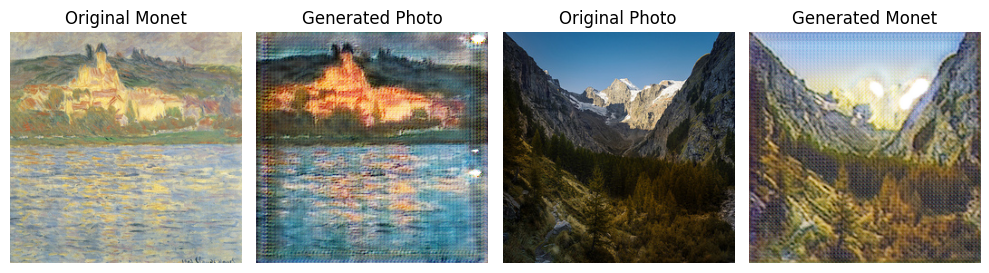

1/1 [==============================] - 5s 5s/step


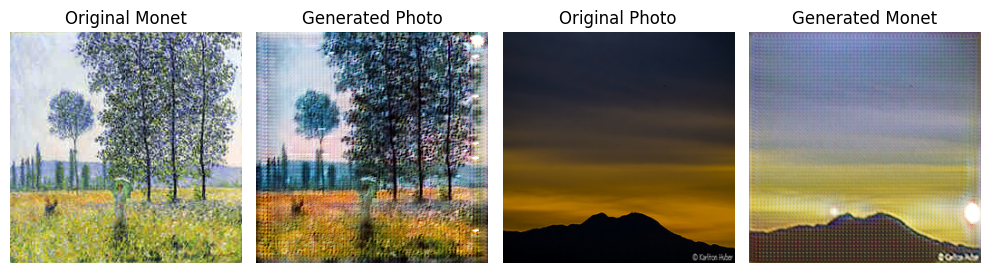

1/1 [==============================] - 5s 5s/step


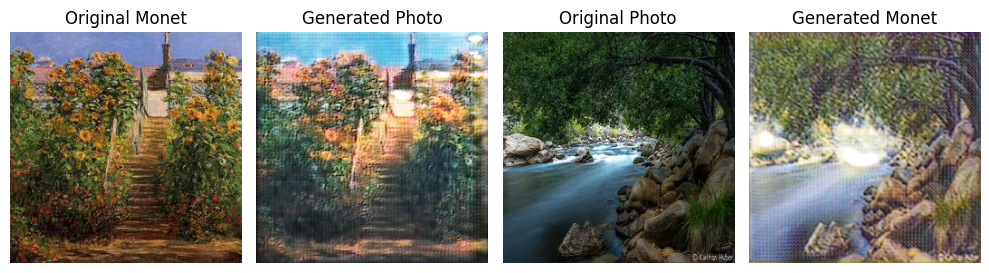

1/1 [==============================] - 5s 5s/step


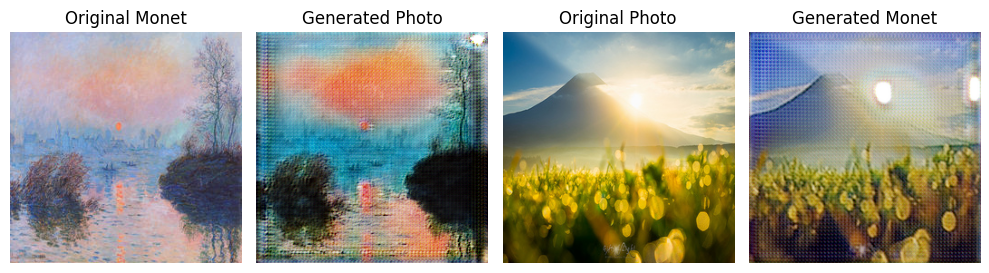

1/1 [==============================] - 5s 5s/step


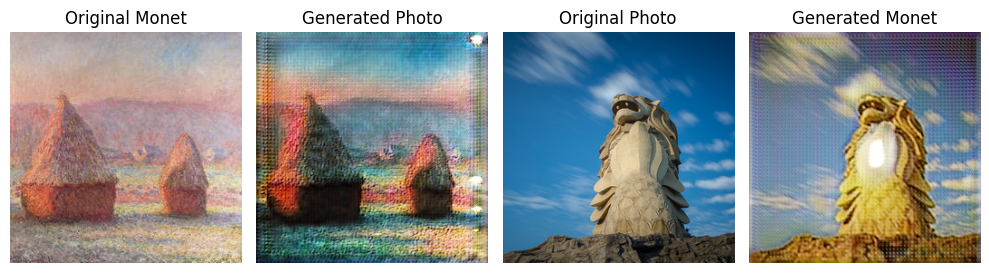

1/1 [==============================] - 5s 5s/step


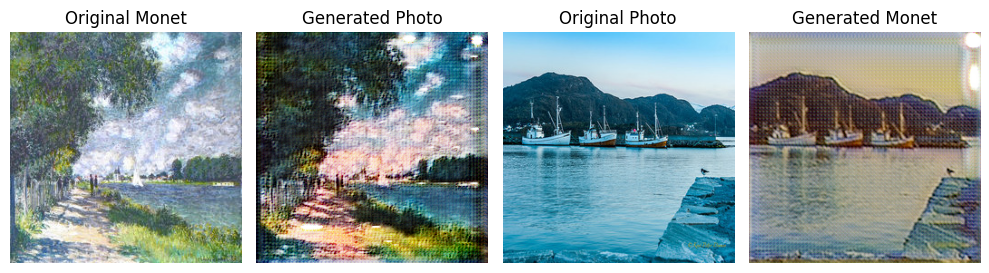

1/1 [==============================] - 5s 5s/step


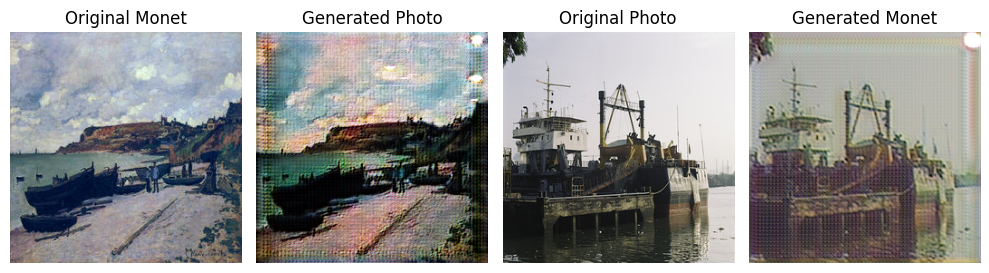

1/1 [==============================] - 5s 5s/step


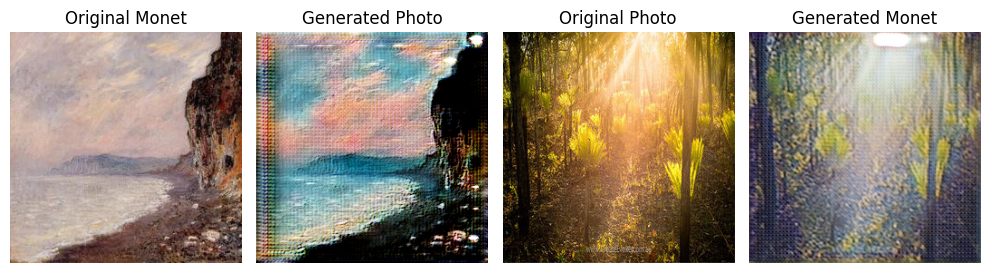

In [ ]:
show_preds(HtoZ_gen, ZtoH_gen, n_images=100)